<a href="https://colab.research.google.com/github/dkimds/BluetoothClient/blob/master/Practice/Appendix/10_2_Logging_%26_tracking_multiple_experiments_ConvNeXt_%26_Full_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<br><br>

<p style="color:red; font-size:1.3em;"> * 본 실습에는 <b>0.13 이상 버전의 torchvision</b> 이 필요합니다.</p><br>
<p style="font-size:1.3em;">* Colab 에서 본 실습 파일을 업로드하고 <span style="color:red;"> <b>GPU 로 런타임을 변경</b></span> 후 실습을 진행해주세요!
    
<br>

<br>
<br>

# Import libraries

In [1]:
from IPython.display import clear_output # Cell 내의 출력을 자동으로 지워주는 함수

!pip install torchvision
!pip install torchinfo
!pip install torchmetrics

clear_output() # clear the output after the installation

In [2]:
import torch
import torchvision

print(torch.__version__)
print(torchvision.__version__) # 0.13 이상 버전의 torchvision 이 필요합니다

import torchinfo
import torchmetrics

print(torchinfo.__version__)    # 1.7.1
print(torchmetrics.__version__) # 0.11.0

2.3.0+cu121
0.18.0+cu121
1.8.0
1.4.0.post0


In [ ]:
!nvidia-smi

# Check the status of the nvidia GPU

Tue Dec  6 07:07:53 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   54C    P0    25W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import torch
from torch import nn

from torch.utils.data import DataLoader # class for loading the dataset (Dataset -> Batches)
# from torch.utils.data import Subset
from torch.utils.tensorboard import SummaryWriter
from torchmetrics import Accuracy
from torchinfo import summary # summarize the model structure

import torchvision
from torchvision import transforms
from torchvision.datasets import ImageFolder # Load "Image" data from selected "Folder"s

import zipfile
import os
import glob
import random
import pickle
from datetime import datetime

from PIL import Image
from tqdm.auto import tqdm # We will use the tqdm
from timeit import default_timer as timer

In [87]:
def set_seeds(seed=42):

    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)

In [6]:
device = "cuda" if torch.cuda.is_available() else "cpu" # "cuda"가 사용 가능하다면 (if it "is available")


device

'cuda'

<br>

# Available experiments

- \# of **epochs**
- \# number of **layers** (hidden units, filters)
- the amount of **training-data** (test-data should remain same as possible)
- the **learning rate**
- the kinds of **data-augmentation**
- the **model architecture**

<br>
<br>

<hr>

# [ Experiment 1 : **EfficientNet_B2** vs **EfficientNet_V2_S** vs **ConvNeXt_Tiny**

<hr>
<br>

### * TorchVision model accuracies on ImageNet-1K @ https://bit.ly/3Fr1Ncq

<br>


In [ ]:
# # EfficientNet_V2_S @ https://bit.ly/3h3knhm

# weights = torchvision.models.EfficientNet_V2_S_Weights.DEFAULT
# model = torchvision.models.efficientnet_v2_s(weights=weights).to(device)

# summary(model=model,
#         input_size=(32, 3, 224, 224),
#         col_names=["input_size", "output_size", "num_params", "trainable"],
#         col_width=20,
#         row_settings=["var_names"]
# )

# # 1280

In [ ]:
# # ConvNeXt_Tiny @ https://bit.ly/3B8Gcms

# weights = torchvision.models.ConvNeXt_Tiny_Weights.DEFAULT
# model = torchvision.models.convnext_tiny(weights=weights).to(device)

# summary(model=model,
#         input_size=(32, 3, 224, 224),
#         col_names=["input_size", "output_size", "num_params", "trainable"],
#         col_width=20,
#         row_settings=["var_names"]
# )

# # 1280

<br>

# 1. Prepare the dataset
<br>

### * Original Dataset : **Food-101** @ https://data.vision.ee.ethz.ch/cvl/datasets_extra/food-101/

<br>

- **101** food categories<br>
- **101,000** images<br>
- **750** training images & **250** test images per class<br>
- rescaled to have a **maximum side length of 512 pixels**

<hr>

#### * 구글드라이브에 [ **data_food101** ] 폴더를 만들고 [ **Food101.zip**, **Food101_20percent.zip**, **sample_pizza.jpg** ] 파일을 업로드

#### * Colab 자동완성 단축키 : [ **Ctrl + Space** ]

<hr>

In [7]:
from google.colab import drive, files # files : for downloading files from Colab & Google Drive

drive.mount('/gdrive') # Mount the google-drive

Mounted at /gdrive


In [8]:
DATA_PATH = '/gdrive/MyDrive/data_food101/'


# with zipfile.ZipFile(DATA_PATH + "Food101.zip", "r") as zip_f:
#     zip_f.extractall(DATA_PATH + "data") # "extract" "all" files
#     print("Complete: Unzipping 10% dataset")


# with zipfile.ZipFile(DATA_PATH + "Food101_20percent.zip", "r") as zip_f:
#     zip_f.extractall(DATA_PATH + "data_20percent") # "extract" "all" files
#     print("Complete: Unzipping 20% dataset")


print('--------- 10% dataset ----------')
for dir_path, dir_names, file_names in os.walk(DATA_PATH + "data"):

    if len(dir_names) == 3:
        print('--------------------------------')

    print("There are {} directories and {} images in '{}'.".format(len(dir_names), len(file_names), dir_path))


print('--------- 20% dataset ----------')
for dir_path, dir_names, file_names in os.walk(DATA_PATH + "data_20percent"):

    if len(dir_names) == 3:
        print('--------------------------------')

    print("There are {} directories and {} images in '{}'.".format(len(dir_names), len(file_names), dir_path))

--------- 10% dataset ----------
There are 2 directories and 0 images in '/gdrive/MyDrive/data_food101/data'.
--------------------------------
There are 3 directories and 0 images in '/gdrive/MyDrive/data_food101/data/test'.
There are 0 directories and 25 images in '/gdrive/MyDrive/data_food101/data/test/pizza'.
There are 0 directories and 19 images in '/gdrive/MyDrive/data_food101/data/test/steak'.
There are 0 directories and 31 images in '/gdrive/MyDrive/data_food101/data/test/sushi'.
--------------------------------
There are 3 directories and 0 images in '/gdrive/MyDrive/data_food101/data/train'.
There are 0 directories and 78 images in '/gdrive/MyDrive/data_food101/data/train/pizza'.
There are 0 directories and 75 images in '/gdrive/MyDrive/data_food101/data/train/steak'.
There are 0 directories and 72 images in '/gdrive/MyDrive/data_food101/data/train/sushi'.
--------- 20% dataset ----------
There are 2 directories and 0 images in '/gdrive/MyDrive/data_food101/data_20percent'.
--

In [9]:
TRAIN_DIR_10_PERCENT = DATA_PATH + "data/train"
TRAIN_DIR_20_PERCENT = DATA_PATH + "data_20percent/train"

TEST_DIR  = DATA_PATH + "data/test" # test-data should remain same as possible

<br>
<br>

# 2. Prepare the DataLoader

In [10]:
# Pre-trained weights (EfficientNet_B0 on ImageNet)
weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT # .DEFAULT = best available weights on ImageNet

# The transforms that were used to train the "EfficientNet_B0_Weights" on "ImageNet"
transform_efficientNet = weights.transforms() # "transforms" that were used to train "weights"


# Load "Image" data from selected "Folder"s
train_10_imgfolder = ImageFolder(root=TRAIN_DIR_10_PERCENT, transform=transform_efficientNet)
train_20_imgfolder = ImageFolder(root=TRAIN_DIR_20_PERCENT, transform=transform_efficientNet)
test_imgfolder     = ImageFolder(root=TEST_DIR,             transform=transform_efficientNet)

CLASS_NAMES = train_10_imgfolder.classes


# class for loading the dataset (Dataset -> Batches)
set_seeds(42)

BATCH_SIZE = 32

train_10_dataloader = DataLoader(dataset=train_10_imgfolder,
                                 batch_size=BATCH_SIZE,
                                 num_workers=os.cpu_count(), # number of subprocesses to use for data loading
                                 shuffle=True,
                                 pin_memory=True)

train_20_dataloader = DataLoader(dataset=train_20_imgfolder,
                                 batch_size=BATCH_SIZE,
                                 num_workers=os.cpu_count(), # number of subprocesses to use for data loading
                                 shuffle=True,
                                 pin_memory=True)

# test-data should remain same as possible
test_dataloader  = DataLoader(dataset=test_imgfolder,
                              batch_size=BATCH_SIZE,
                              num_workers=os.cpu_count(),
                              shuffle=False,
                              pin_memory=True)

In [ ]:
# batch_x, batch_y = next(iter(train_10_dataloader))

# image_sample = batch_x[0]

# print(type(image_sample))
# print(image_sample.shape) # after the data-augmentation
# print(image_sample.dtype)

# plt.imshow(image_sample.permute(1, 2, 0)) # permutation
# plt.axis("off")
# plt.show()

<br>
<br>

# 3. Create functions for the experiment

### 1-1) Model-builder (Basic)

In [ ]:
# summary(model=model,
#         input_size=(32, 3, 224, 224),
#         col_names=["input_size", "output_size", "num_params", "trainable"],
#         col_width=20,
#         row_settings=["var_names"]
# )

In [11]:
# EfficientNet_B2 @ https://bit.ly/3izrApL
# num_params : 9,109,994

weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT # .DEFAULT = best available weights on ImageNet
model   = torchvision.models.efficientnet_b2(weights=weights).to(device)

model.classifier

Downloading: "https://download.pytorch.org/models/efficientnet_b2_rwightman-c35c1473.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b2_rwightman-c35c1473.pth
100%|██████████| 35.2M/35.2M [00:00<00:00, 98.3MB/s]


Sequential(
  (0): Dropout(p=0.3, inplace=True)
  (1): Linear(in_features=1408, out_features=1000, bias=True)
)

In [12]:
# EfficientNet_V2_S @ https://bit.ly/3h3knhm
# num_params : 21,458,488

weights = torchvision.models.EfficientNet_V2_S_Weights.DEFAULT # .DEFAULT = best available weights on ImageNet
model = torchvision.models.efficientnet_v2_s(weights=weights).to(device)

model.classifier

Downloading: "https://download.pytorch.org/models/efficientnet_v2_s-dd5fe13b.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_v2_s-dd5fe13b.pth
100%|██████████| 82.7M/82.7M [00:00<00:00, 119MB/s]


Sequential(
  (0): Dropout(p=0.2, inplace=True)
  (1): Linear(in_features=1280, out_features=1000, bias=True)
)

In [13]:
# ConvNeXt_Tiny @ https://bit.ly/3B8Gcms
# num_params : 28,589,128

weights = torchvision.models.ConvNeXt_Tiny_Weights.DEFAULT # .DEFAULT = best available weights on ImageNet
model = torchvision.models.convnext_tiny(weights=weights).to(device)

model.classifier

Downloading: "https://download.pytorch.org/models/convnext_tiny-983f1562.pth" to /root/.cache/torch/hub/checkpoints/convnext_tiny-983f1562.pth
100%|██████████| 109M/109M [00:00<00:00, 135MB/s] 


Sequential(
  (0): LayerNorm2d((768,), eps=1e-06, elementwise_affine=True)
  (1): Flatten(start_dim=1, end_dim=-1)
  (2): Linear(in_features=768, out_features=1000, bias=True)
)

In [29]:
def build_model(model_name, out_features, device):


    if model_name == 'EfficientNet_B2':

        weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT # .DEFAULT = best available weights on ImageNet
        model   = torchvision.models.efficientnet_b2(weights=weights)

        # Sequential (classifier)
        set_seeds(42)
        model.classifier = nn.Sequential(
            nn.Dropout(p=0.3, inplace=True), # Apply the drop-out
            nn.Linear(in_features=1408, out_features=out_features) # "in_features" for the classifier layer
        )


    elif model_name == "EfficientNet_V2_S":

        weights = torchvision.models.EfficientNet_V2_S_Weights.DEFAULT # .DEFAULT = best available weights on ImageNet
        model = torchvision.models.efficientnet_v2_s(weights=weights)

        # Sequential (classifier)
        set_seeds(42)
        model.classifier = nn.Sequential(
            nn.Dropout(p=0.2, inplace=True), # Apply the drop-out
            nn.Linear(in_features=1280, out_features=out_features) # "in_features" for the classifier layer
        )


    elif model_name == "ConvNeXt_Tiny":

        weights = torchvision.models.ConvNeXt_Tiny_Weights.DEFAULT # .DEFAULT = best available weights on ImageNet
        model = torchvision.models.convnext_tiny(weights=weights)

        # Sequential (classifier)
        set_seeds(42)
        model.classifier = nn.Sequential(
            nn.LayerNorm2d((768,), eps=1e-06, elementwise_affine=True), # This line occurs an error
            nn.Flatten(start_dim=1, end_dim=-1),
            nn.Linear(in_features=768, out_features=out_features) # "in_features" for the classifier layer
        )


    # Sequential (features)
    for param in model.features.parameters():
        param.requires_grad = False # "requires" "grad"ient-descent


    model.name = model_name # We can set the model's name
    model = model.to(device)

    print("[INFO] Created new [{}] model".format(model.name))

    return model

<br>

### 1-2) Model-builder (Advanced)

1-2-1) **str** variable -> weights & model

In [30]:
weights = torchvision.models.ConvNeXt_Tiny_Weights.DEFAULT
model = torchvision.models.convnext_tiny(weights=weights)

# # Sequential (classifier)
# set_seeds(42)
# model.classifier = nn.Sequential(
#     nn.LayerNorm2d((768,), eps=1e-06, elementwise_affine=True),
#     nn.Flatten(start_dim=1, end_dim=-1),
#     nn.Linear(in_features=768, out_features=out_features) # "in_features" for the classifier layer
# )

In [31]:
exec("test_num = 42") # "exec"ute

test_num

42

In [32]:
exec("weights = torchvision.models.{}_Weights.DEFAULT".format('ConvNeXt_Tiny')) # "exec"ute

weights

ConvNeXt_Tiny_Weights.IMAGENET1K_V1

In [33]:
exec("model = torchvision.models.{}(weights=weights)".format('ConvNeXt_Tiny'.lower()))

model.classifier

Sequential(
  (0): LayerNorm2d((768,), eps=1e-06, elementwise_affine=True)
  (1): Flatten(start_dim=1, end_dim=-1)
  (2): Linear(in_features=768, out_features=1000, bias=True)
)

1-2-2) modify the classifier automatically

In [34]:
model.classifier # Classification layer of the model

Sequential(
  (0): LayerNorm2d((768,), eps=1e-06, elementwise_affine=True)
  (1): Flatten(start_dim=1, end_dim=-1)
  (2): Linear(in_features=768, out_features=1000, bias=True)
)

In [35]:
model.classifier[-1] # 순서 상 가장 마지막에 위치한 Linear 레이어를 접근하려면?

Linear(in_features=768, out_features=1000, bias=True)

In [36]:
model.classifier[-1] = nn.Linear(in_features=768, out_features=3)

In [37]:
model.classifier[-1].in_features # Linear("in_features"=768, out_features=1000, bias=True)

768

In [38]:
model.classifier[-1] = nn.Linear(in_features=model.classifier[-1].in_features, out_features=3)

In [39]:
model.classifier

Sequential(
  (0): LayerNorm2d((768,), eps=1e-06, elementwise_affine=True)
  (1): Flatten(start_dim=1, end_dim=-1)
  (2): Linear(in_features=768, out_features=3, bias=True)
)

1-2-3) Improve the Model-builder

In [40]:
def build_model(model_name, out_features, device):

    set_seeds(42)

    # weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT
    # model   = torchvision.models.efficientnet_b2(weights=weights)

    # 함수 내에서는 locals 를 활용해줘야 정상적으로 지역변수로 선언되고 reference 에러가 발생하지 않습니다. (https://bit.ly/3FuxDVF)
    local_context = locals()

    exec("weights = torchvision.models.{}_Weights.DEFAULT".format(model_name), None, local_context)
    exec("model = torchvision.models.{}(weights=weights)".format(model_name.lower()), None, local_context)

    weights = local_context['weights']
    model   = local_context['model']


    # Sequential (features)
    for param in model.features.parameters():
        param.requires = False # "requires" "grad"ient-descent


    # Sequential (classifier)
    model.classifier[-1] = nn.Linear(in_features=model.classifier[-1].in_features,
                                     out_features=out_features)


    model.name = model_name # We can set the model's name
    model = model.to(device)

    print("[INFO] Created new [{}] model".format(model.name))

    return model

<br>

### 2) SummaryWriter

In [ ]:
# log_dir ->  [ runs/YYYY-MM-DD/name_dataset/name_model/etc ] (etc : the number of epochs, the kind of augmentation, etc.)

In [15]:
def create_writer(name_dataset, name_model, etc):

    timestamp = datetime.now().strftime("%Y-%m-%d") # Today's date with the string-format "YYYY-MM-DD"

    if etc:
        log_dir = os.path.join("runs", timestamp, name_dataset, name_model, etc) # Join multiple directory names
    else:
        log_dir = os.path.join("runs", timestamp, name_dataset, name_model)

    print("[INFO] SummaryWriter will save the results to: {}...".format(log_dir))

    return SummaryWriter(log_dir=log_dir) # from torch.utils.tensorboard import SummaryWriter

<br>

### 3) Model-saver

In [16]:
def save_model(model,
               target_dir,
               model_name):

    os.makedirs(target_dir, exist_ok=True) # Make directories

    model_save_path = target_dir + '/' + model_name
    print("[INFO] Saving model to: {}".format(model_save_path))

    torch.save(obj=model.state_dict(),
               f=model_save_path)

<br>

### 4) Train-step & Test-step

In [24]:
def train_step(model, dataloader, loss_fn, optimizer, metric, device):

    # 모델을 training mode로 설정 (default state)
    model.train()

    # train-loss & train-accuracy for one epoch
    train_loss = 0
    train_acc  = 0

    for batch_idx, (X, y) in enumerate(dataloader): # X & y == a single batch

        X = X.to(device)
        y = y.to(device)

        # 1. (x 데이터를 모델에 넣고) 순방향 계산 진행 (forward pass)
        logits = model(X)

        # 2. (Batch) Training cost 계산 (Cost function 계산)
        loss = loss_fn(logits, y) # cost of batch <- nn.CrossEntropyLoss() : built-in Softmax
        train_loss += loss.item()

        # 3. Optimizer 내부의 이전 gradient 값 초기화 (Make "grad" to "zero")
        optimizer.zero_grad()

        # 4. Back-propagation ("Backward" propagation)
        loss.backward()

        # 5. Gradient descent 진행 (Take a "step" to update parameters)
        optimizer.step()

        # 6. (Batch) Training accuracy 계산
        predicted_classes = logits.softmax(dim=1).argmax(dim=1)
        train_acc += metric(predicted_classes, y).item() # calculate the batch accuracy & add to the epoch accuracy


    # Batch 순회 종료 후
    train_loss = train_loss / len(dataloader) # cost of batches / num of batches (calculate average)
    train_acc  = train_acc  / len(dataloader) # acc  of batches / num of batches (calculate average)

    return train_loss, train_acc

In [19]:
def test_step(model, dataloader, loss_fn, metric, device):

    # 모델을 evaluation mode로 설정
    model.eval()

    # test-loss & test-accuracy for one epoch
    test_loss = 0
    test_acc  = 0

    with torch.inference_mode(): # Set "inference mode"

        for batch_idx, (X, y) in enumerate(dataloader): # X & y == a single batch

            X = X.to(device)
            y = y.to(device)

            # 1. (x 데이터를 모델에 넣고) 순방향 계산 진행 (forward pass)
            logits = model(X)

            # 2. (Batch) Test cost 계산 (Cost function 계산)
            loss = loss_fn(logits, y) # cost of batch <- nn.CrossEntropyLoss() : built-in Softmax
            test_loss += loss.item()

            # 3. (Batch) Test accuracy 계산
            predicted_classes = logits.softmax(dim=1).argmax(dim=1)
            test_acc += metric(predicted_classes, y).item() # calculate the batch accuracy & add to the epoch accuracy


    # Batch 순회 종료 후
    test_loss = test_loss / len(dataloader) # cost of batches / num of batches (calculate average)
    test_acc  = test_acc  / len(dataloader) # acc  of batches / num of batches (calculate average)

    return test_loss, test_acc

<br>

### 5) Combine train & test step into a simplified "train" function (+ SummaryWriter)

In [20]:
def train(model,
          train_dataloader,
          test_dataloader,
          optimizer,
          loss_fn,
          metric,
          device,
          epochs,
          writer):


    results = {"train_loss": [],
               "train_acc" : [],
               "test_loss" : [],
               "test_acc"  : []}

    for epoch in tqdm(range(epochs)): # from tqdm.auto import tqdm

        train_loss, train_acc = train_step(model=model,
                                           dataloader=train_dataloader,
                                           loss_fn=loss_fn,
                                           optimizer=optimizer,
                                           metric=metric,
                                           device=device)

        test_loss, test_acc   = test_step(model=model,
                                          dataloader=test_dataloader,
                                          loss_fn=loss_fn,
                                          metric=metric,
                                          device=device)


        results["train_loss"].append(train_loss)
        results["train_acc"].append(train_acc)
        results["test_loss"].append(test_loss)
        results["test_acc"].append(test_acc)


        print('Epoch : {} | Train_loss : {} | Train_acc : {} | Test_loss : {} | Test_acc : {}'.format(epoch+1,
                                                                                                      train_loss,
                                                                                                      train_acc,
                                                                                                      test_loss,
                                                                                                      test_acc))

        # for tensorboard.SummaryWriter
        if  writer:

            writer.add_scalars(main_tag="Loss",
                               tag_scalar_dict={"train_loss": train_loss,
                                                "test_loss" : test_loss},
                               global_step=epoch) # Global step value to record -> set "epoch"

            writer.add_scalars(main_tag="Accuracy",
                               tag_scalar_dict={"train_acc": train_acc,
                                                "test_acc" : test_acc},
                               global_step=epoch) # Global step value to record -> set "epoch"

            writer.close() # Close the tensorboard.SummaryWriter

        else:
            pass

    return results

<br>
<br>

# 4. Run the multiple experiments

<br>

### 1) Set the scope of the experiments

In [42]:
# Scope 1. The size of the training dataset
candidate_loaders = {"data_10_percent": train_10_dataloader,
                     "data_20_percent": train_20_dataloader}

# Scope 2. The architecture of the model
candidate_models = ["EfficientNet_B2", "EfficientNet_V2_S", "ConvNeXt_Tiny"] # Try other models if possible
# candidate_models = ["ConvNeXt_Tiny"] # Try other models if possible
# Scope 3. The number of epochs
# candidate_epochs = [15, 30]

<br>

### 2) Run multiple experiments at once

In [48]:
%%time


set_seeds(42)

EPOCHS = 30

idx_experiment = 0 # will be used as an identifier of the saved models (.pth)

result_per_model = {} # will collect the best test-accuracy of each model


# Scope 1. The size of the training dataset (10% or 20%)
for name_dataloader, train_dataloader in candidate_loaders.items():

    # Scope 2. The architecture of the model (EfficientNet_B2 vs EfficientNet_V2_S vs ConvNeXt_Tiny)
    for model_name in candidate_models:


        # 1) print the settings of the current experiment
        idx_experiment += 1
        print("[INFO] Experiment  : {}".format(idx_experiment))
        print("[INFO] Model       : {}".format(model_name))
        print("[INFO] DataLoader  : {}".format(name_dataloader))
        print("[INFO] # of epochs : {}".format(EPOCHS))


        # 2) Build the model
        model = build_model(model_name, out_features=3, device=device) # "EfficientNet_B2" or "EfficientNet_V2_S" or "ConvNeXt_Tiny"


        # 3) Train the model
        loss_fn = nn.CrossEntropyLoss() # Softmax + CrossEntropy (built-in Softmax)
        optimizer = torch.optim.Adam(lr=0.001, params=model.parameters()) # "parameters" to optimize (apply gradient descent)
        metric_accuracy = Accuracy(task="multiclass", num_classes=3).to(device) # from torchmetrics import Accuracy

        writer = create_writer(name_dataset=name_dataloader,
                                name_model=model_name,
                                etc='{}_epochs'.format(EPOCHS))

        model_results = train(model=model,
                            train_dataloader=train_dataloader,
                            test_dataloader=test_dataloader,
                            optimizer=optimizer,
                            loss_fn=loss_fn,
                            metric=metric_accuracy,
                            device=device,
                            epochs=EPOCHS,
                            writer=writer)


        # 4) Save the model (params)
        save_filepath = "{}_{}_{}_{}_epochs.pth".format(idx_experiment, model_name, name_dataloader, EPOCHS)

        save_model(model=model,
                    target_dir='/gdrive/MyDrive/data_food101/models',
                    model_name=save_filepath)


        # 5) Collect the best test-accuracy of the current experiment
        result_per_model[save_filepath[:-4]] = max(model_results['test_acc'])

        print("-" * 50 + "\n")


# Save the summary of the experiments (the best test-accuracy of each experiment)
with open('/gdrive/MyDrive/data_food101/' + 'experiments_summary_2.pkl', 'wb') as f:
    pickle.dump(result_per_model, f) # Save the summary result as a pickle file

files.download('/gdrive/MyDrive/data_food101/' + 'experiments_summary_2.pkl') # from google.colab import files

[INFO] Experiment  : 1
[INFO] Model       : EfficientNet_B2
[INFO] DataLoader  : data_10_percent
[INFO] # of epochs : 30
[INFO] Created new [EfficientNet_B2] model
[INFO] SummaryWriter will save the results to: runs/2024-07-12/data_10_percent/EfficientNet_B2/30_epochs...


  0%|          | 0/30 [00:00<?, ?it/s]

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Epoch : 1 | Train_loss : 0.5939325466752052 | Train_acc : 0.8359375 | Test_loss : 0.2633291532595952 | Test_acc : 0.9488636453946432
Epoch : 2 | Train_loss : 0.07528322096914053 | Train_acc : 0.98828125 | Test_loss : 0.4138072108229001 | Test_acc : 0.908143937587738
Epoch : 3 | Train_loss : 0.35628739671665244 | Train_acc : 0.86328125 | Test_loss : 0.5117710878451666 | Test_acc : 0.9071969787279764
Epoch : 4 | Train_loss : 0.2138436243403703 | Train_acc : 0.9609375 | Test_loss : 0.6459479127079248 | Test_acc : 0.8958333333333334
Epoch : 5 | Train_loss : 0.20986459573032334 | Train_acc : 0.859375 | Test_loss : 0.4460543394088745 | Test_acc : 0.9280303120613098
Epoch : 6 | Train_loss : 0.44399013626389205 | Train_acc : 0.84765625 | Test_loss : 0.5988633433977762 | Test_acc : 0.9280303120613098
Epoch : 7 | Train_loss : 0.5590481229592115 | Train_acc : 0.859375 | Test_loss : 0.2502742999543746 | Test_acc : 0.9375
Epoch : 8 | Train_loss : 0.19542315893340856 | Train_acc : 0.85546875 | Test_

  0%|          | 0/30 [00:00<?, ?it/s]

Epoch : 1 | Train_loss : 0.6176047157496214 | Train_acc : 0.8046875 | Test_loss : 0.1919247731566429 | Test_acc : 0.9280303120613098
Epoch : 2 | Train_loss : 0.22967675887048244 | Train_acc : 0.9609375 | Test_loss : 0.41537636642654735 | Test_acc : 0.90625
Epoch : 3 | Train_loss : 0.15181878441944718 | Train_acc : 0.94140625 | Test_loss : 0.4215285175790389 | Test_acc : 0.8958333333333334
Epoch : 4 | Train_loss : 0.1078853472135961 | Train_acc : 0.96875 | Test_loss : 0.30459799865881604 | Test_acc : 0.8863636453946432
Epoch : 5 | Train_loss : 0.5091482591815293 | Train_acc : 0.8359375 | Test_loss : 0.238020078279078 | Test_acc : 0.8958333333333334
Epoch : 6 | Train_loss : 0.4520542686805129 | Train_acc : 0.84765625 | Test_loss : 0.24475163469711939 | Test_acc : 0.8977272709210714
Epoch : 7 | Train_loss : 0.2592785677406937 | Train_acc : 0.8515625 | Test_loss : 0.2832675725221634 | Test_acc : 0.8882575829823812
Epoch : 8 | Train_loss : 0.3476577957626432 | Train_acc : 0.84375 | Test_los

  0%|          | 0/30 [00:00<?, ?it/s]

Epoch : 1 | Train_loss : 1.1173544004559517 | Train_acc : 0.35546875 | Test_loss : 1.5365286866823833 | Test_acc : 0.4630681872367859
Epoch : 2 | Train_loss : 1.036359928548336 | Train_acc : 0.44921875 | Test_loss : 2.0039002895355225 | Test_acc : 0.375
Epoch : 3 | Train_loss : 1.1152485981583595 | Train_acc : 0.484375 | Test_loss : 0.9395044247309366 | Test_acc : 0.5520833333333334
Epoch : 4 | Train_loss : 0.884489931166172 | Train_acc : 0.64453125 | Test_loss : 1.2364328304926555 | Test_acc : 0.3626893957455953
Epoch : 5 | Train_loss : 0.6070095095783472 | Train_acc : 0.75 | Test_loss : 0.7963937024275461 | Test_acc : 0.75
Epoch : 6 | Train_loss : 0.6146360682323575 | Train_acc : 0.79296875 | Test_loss : 0.5468699658910433 | Test_acc : 0.8333333333333334
Epoch : 7 | Train_loss : 0.3797448385739699 | Train_acc : 0.89453125 | Test_loss : 0.3900810778141022 | Test_acc : 0.90625
Epoch : 8 | Train_loss : 0.22576441150158644 | Train_acc : 0.94140625 | Test_loss : 0.3765239169200261 | Test_

  0%|          | 0/30 [00:00<?, ?it/s]

Epoch : 1 | Train_loss : 0.5693828215201696 | Train_acc : 0.8041666666666667 | Test_loss : 0.14182422558466592 | Test_acc : 0.9583333333333334
Epoch : 2 | Train_loss : 0.22804282506306967 | Train_acc : 0.9229166666666667 | Test_loss : 0.38828765352567035 | Test_acc : 0.9384469787279764
Epoch : 3 | Train_loss : 0.14490767680108546 | Train_acc : 0.9520833333333333 | Test_loss : 0.5327523748079935 | Test_acc : 0.9185606042544047
Epoch : 4 | Train_loss : 0.2127067256718874 | Train_acc : 0.93125 | Test_loss : 0.18364931643009186 | Test_acc : 0.9384469787279764
Epoch : 5 | Train_loss : 0.12015964761376381 | Train_acc : 0.9583333333333334 | Test_loss : 0.28460366527239483 | Test_acc : 0.9280303120613098
Epoch : 6 | Train_loss : 0.1598758510624369 | Train_acc : 0.9583333333333334 | Test_loss : 0.24481591085592905 | Test_acc : 0.9384469787279764
Epoch : 7 | Train_loss : 0.17526504105577867 | Train_acc : 0.94375 | Test_loss : 0.4006187518437703 | Test_acc : 0.8759469787279764
Epoch : 8 | Train_l

  0%|          | 0/30 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


Epoch : 1 | Train_loss : 0.4655769541859627 | Train_acc : 0.8354166666666667 | Test_loss : 0.42359549303849536 | Test_acc : 0.9176136453946432
Epoch : 2 | Train_loss : 0.32335909803708396 | Train_acc : 0.8604166666666667 | Test_loss : 0.263674721121788 | Test_acc : 0.8977272709210714
Epoch : 3 | Train_loss : 0.3445933232704798 | Train_acc : 0.8833333333333333 | Test_loss : 0.4231085926294327 | Test_acc : 0.8551136453946432
Epoch : 4 | Train_loss : 0.24584697857499122 | Train_acc : 0.9104166666666667 | Test_loss : 0.19375573843717575 | Test_acc : 0.9479166666666666
Epoch : 5 | Train_loss : 0.1390253885338704 | Train_acc : 0.9583333333333334 | Test_loss : 0.3947295534114043 | Test_acc : 0.90625
Epoch : 6 | Train_loss : 0.16289439275860787 | Train_acc : 0.9625 | Test_loss : 0.33944544196128845 | Test_acc : 0.8967803120613098
Epoch : 7 | Train_loss : 0.34854929347832997 | Train_acc : 0.9041666666666667 | Test_loss : 0.6299059862891833 | Test_acc : 0.7651515205701193
Epoch : 8 | Train_loss 

  0%|          | 0/30 [00:00<?, ?it/s]

Epoch : 1 | Train_loss : 0.9583133061726888 | Train_acc : 0.5895833333333333 | Test_loss : 0.6934779087702433 | Test_acc : 0.6827651560306549
Epoch : 2 | Train_loss : 0.43571224672098957 | Train_acc : 0.85 | Test_loss : 0.5452658931414286 | Test_acc : 0.7736742496490479
Epoch : 3 | Train_loss : 0.23839349895715714 | Train_acc : 0.925 | Test_loss : 0.18757628152767816 | Test_acc : 0.9176136453946432
Epoch : 4 | Train_loss : 0.08575091714155861 | Train_acc : 0.9666666666666667 | Test_loss : 0.5175051813324293 | Test_acc : 0.8560606042544047
Epoch : 5 | Train_loss : 0.15794617746335765 | Train_acc : 0.9291666666666667 | Test_loss : 0.24353519082069397 | Test_acc : 0.9270833333333334
Epoch : 6 | Train_loss : 0.043172780377790335 | Train_acc : 0.9916666666666667 | Test_loss : 0.9500059708952904 | Test_acc : 0.8238636453946432
Epoch : 7 | Train_loss : 0.5849820012226701 | Train_acc : 0.81875 | Test_loss : 0.2541841169198354 | Test_acc : 0.9375
Epoch : 8 | Train_loss : 0.19158869522313277 | T

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

CPU times: user 9min 33s, sys: 1min 12s, total: 10min 46s
Wall time: 19min 41s


<br>

### 3) Check the result of the experiment

In [49]:
# Load the TensorBoard
%reload_ext tensorboard

# Run TensorBoard session with the "runs/" directory (== writer 가 결과값을 저장하는 directory)
%tensorboard --logdir runs

# Set "Smoothing"(moving average) as 0 & Filter "runs" with the word "test_"
# Check the Colab's local directory ("runs/")

Reusing TensorBoard on port 6006 (pid 20288), started 0:27:32 ago. (Use '!kill 20288' to kill it.)

<IPython.core.display.Javascript object>

In [50]:
# Delete the previous results of the Tensorboard

!rm -rf runs

<br>
<br>

# 5. Load the best model & predict on several images

#### * (**TensorBoard** -> **DataFrame**) TensorBoard 데이터에 DataFrame으로 액세스하기 @ https://bit.ly/3VMnetC

In [ ]:
# from google.colab import files

# files.upload() # Directly upload the file 'experiments_summary_2.pkl' to the Colab's local directory.

In [51]:
# from google.colab import drive

# drive.mount('/gdrive') # Mount the google-drive

with open('/gdrive/MyDrive/data_food101/' + 'experiments_summary_2.pkl', 'rb') as f:
    experiments_summary = pickle.load(f) # Load the data from a pickle file

experiments_summary

{'1_EfficientNet_B2_data_10_percent_30_epochs': 0.96875,
 '2_EfficientNet_V2_S_data_10_percent_30_epochs': 0.9583333333333334,
 '3_ConvNeXt_Tiny_data_10_percent_30_epochs': 0.9166666666666666,
 '4_EfficientNet_B2_data_20_percent_30_epochs': 0.9583333333333334,
 '5_EfficientNet_V2_S_data_20_percent_30_epochs': 0.9583333333333334,
 '6_ConvNeXt_Tiny_data_20_percent_30_epochs': 0.9479166666666666}

In [53]:
df_summary = pd.DataFrame(data = experiments_summary.items(),
                          columns=['Experiment', 'Test accuracy'])

df_summary = df_summary.sort_values('Test accuracy', ascending=False)

df_summary

# Model      : ConvNeXt_Tiny
# DataLoader : data_20_percent (20%)
# Epochs     : 30

,Experiment,Test accuracy
0,1_EfficientNet_B2_data_10_percent_30_epochs,0.968750
1,2_EfficientNet_V2_S_data_10_percent_30_epochs,0.958333
3,4_EfficientNet_B2_data_20_percent_30_epochs,0.958333
4,5_EfficientNet_V2_S_data_20_percent_30_epochs,0.958333
5,6_ConvNeXt_Tiny_data_20_percent_30_epochs,0.947917
2,3_ConvNeXt_Tiny_data_10_percent_30_epochs,0.916667


In [57]:
# Initialize the model
best_model = build_model('EfficientNet_B2', out_features=3, device=device)

# Load the saved parameters
best_model_path = "/gdrive/MyDrive/data_food101/models/" + "1_EfficientNet_B2_data_10_percent_30_epochs.pth"
best_model.load_state_dict(torch.load(best_model_path)) # load -> load_state_dict

[INFO] Created new [EfficientNet_B2] model


<All keys matched successfully>

In [58]:
def predict_img(model, image_path, class_names, transform, device):

    img = Image.open(image_path) # from PIL import Image

    if transform is not None:
      image_transform = transform
    else:
      image_transform = transforms.Compose([
          transforms.Resize((224, 224)), # ImageNet
          transforms.ToTensor(), # value / 255.0
          transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                std=[0.229, 0.224, 0.225]),
      ])

    img_tensor = image_transform(img).to(device)
    img_tensor = img_tensor.unsqueeze(dim=0) # [Channels, Height, Width] -> [Batch_size, Channels, Height, Width]


    model.to(device)
    model.eval()

    with torch.inference_mode():
        img_logits = model(img_tensor)


    predicted_prob = img_logits.softmax(dim=1).max(dim=1)[0].item()
    predicted_class = img_logits.softmax(dim=1).argmax(dim=1)
    predicted_class_name = class_names[predicted_class]


    plt.figure(figsize=(5, 5), dpi=100)
    plt.imshow(img)

    title = "Pred: {} | Prob: {:.2f}%".format(predicted_class_name, predicted_prob * 100)
    plt.title(title)
    plt.axis(False)
    plt.show()

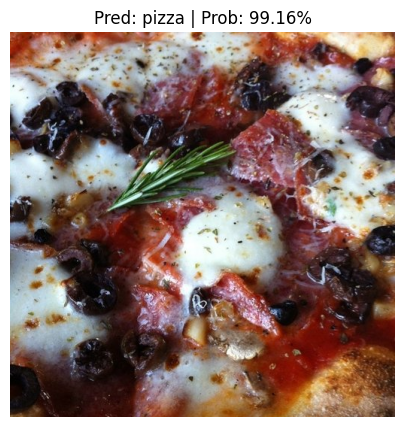

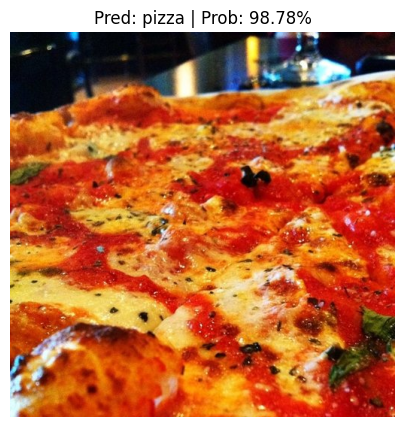

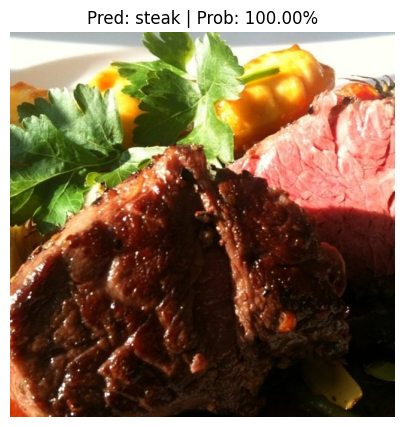

In [59]:
TEST_DIR  = DATA_PATH + "data/test" # test-data should remain same as possible

test_images = glob.glob(TEST_DIR+"/*/*.jpg")
random_img_3 = random.sample(test_images, k=3)

weights = torchvision.models.ConvNeXt_Tiny_Weights.DEFAULT
transform_convnext_tiny = weights.transforms()


for image_path in random_img_3:

    predict_img(model=best_model,
                image_path=image_path,
                class_names=['pizza', 'steak', 'sushi'],
                transform=transform_convnext_tiny,
                device=device)

<br>
<br>
<br>

<hr>

# [ Experiment 2 : 20% of Training-data vs 100% of Training-data

<hr>
<br>

### * torchvision.datasets.Food101 @ https://bit.ly/3VSGqWH

<br>



# 1. Prepare the dataset
<br>

### * Original Dataset : **Food-101** @ https://data.vision.ee.ethz.ch/cvl/datasets_extra/food-101/

<br>

- **101** food categories<br>
- **101,000** images<br>
- **750** training images & **250** test images per class<br>
- rescaled to have a **maximum side length of 512 pixels**

<br>

### 1) Prepare the full dataset (100%, 750 per class)

In [60]:
# Pre-trained weights (ConvNeXt_Tiny_Weights on ImageNet)

weights = torchvision.models.ConvNeXt_Tiny_Weights.DEFAULT # .DEFAULT = best available weights on ImageNet
transform_convnext_tiny = weights.transforms() # "transforms" that were used to train "weights"


# Load the Food101 dataset
train_data = torchvision.datasets.Food101(root="data_full", # Download data into the Colab's local drive
                                          split="train",
                                          transform=transform_convnext_tiny,
                                          download=True)

test_data  = torchvision.datasets.Food101(root="data_full",
                                          split="test",
                                          transform=transform_convnext_tiny,
                                          download=True)

100%|██████████| 4996278331/4996278331 [00:54<00:00, 92081368.21it/s] 


Extracting data_full/food-101.tar.gz to data_full


In [62]:
print(len(train_data) + len(test_data))

print(len(train_data), len(train_data) / 101) # 101 food categories
print(len(test_data),  len(test_data)  / 101)

101000
75750 750.0
25250 250.0


In [ ]:
# train_data.class_to_idx

In [63]:
for key in train_data.class_to_idx:
    if key in ['pizza', 'steak', 'sushi']:
        print(key, ':', train_data.class_to_idx[key])

pizza : 76
steak : 93
sushi : 95


In [ ]:
# train_data._labels

In [64]:
len(train_data._labels)

75750

In [67]:
from torch.utils.data import Subset # Make a "Subset" of a PyTorch Dataset variable

target_idx = []

for idx, label in enumerate(train_data._labels):
    if label in [76, 93, 95]:
        target_idx.append(idx)
    else:
        pass

train_data = Subset(train_data, target_idx) # Make a "Subset" of a PyTorch Dataset variable (with the index numbers)

In [68]:
len(train_data) / 3 # 750 per class * 3 classes

750.0

In [69]:
target_idx = []

for idx, label in enumerate(test_data._labels):
    if label in [76, 93, 95]:
        target_idx.append(idx)
    else:
        pass

test_data = Subset(test_data, target_idx)

In [70]:
len(test_data) / 3 # 250 per class

250.0

<br>

### 2) Prepare the 20% dataset (150 per class)

In [ ]:
from google.colab import drive

drive.mount('/gdrive') # Mount the google-drive

Mounted at /gdrive


In [71]:
DATA_PATH = '/gdrive/MyDrive/data_food101/'


# with zipfile.ZipFile(DATA_PATH + "Food101_20percent.zip", "r") as zip_f:
#     zip_f.extractall(DATA_PATH + "data_20percent") # "extract" "all" files
#     print("Complete: Unzipping 20% dataset")


for dir_path, dir_names, file_names in os.walk(DATA_PATH + "data_20percent"): # 거닐다

    if len(dir_names) == 3:
        print('--------------------------------')

    print("There are {} directories and {} images in '{}'.".format(len(dir_names), len(file_names), dir_path))

There are 2 directories and 0 images in '/gdrive/MyDrive/data_food101/data_20percent'.
--------------------------------
There are 3 directories and 0 images in '/gdrive/MyDrive/data_food101/data_20percent/test'.
There are 0 directories and 46 images in '/gdrive/MyDrive/data_food101/data_20percent/test/pizza'.
There are 0 directories and 58 images in '/gdrive/MyDrive/data_food101/data_20percent/test/steak'.
There are 0 directories and 46 images in '/gdrive/MyDrive/data_food101/data_20percent/test/sushi'.
--------------------------------
There are 3 directories and 0 images in '/gdrive/MyDrive/data_food101/data_20percent/train'.
There are 0 directories and 154 images in '/gdrive/MyDrive/data_food101/data_20percent/train/pizza'.
There are 0 directories and 146 images in '/gdrive/MyDrive/data_food101/data_20percent/train/steak'.
There are 0 directories and 150 images in '/gdrive/MyDrive/data_food101/data_20percent/train/sushi'.


In [72]:
TRAIN_DIR_20_PERCENT = DATA_PATH + "data_20percent/train"

<br>
<br>

# 2. Prepare the DataLoader

In [73]:
# weights = torchvision.models.ConvNeXt_Tiny_Weights.DEFAULT # .DEFAULT = best available weights on ImageNet
# transform_convnext_tiny = weights.transforms() # "transforms" that were used to train "weights"

set_seeds(42)


# Load "Image" data from selected "Folder"s

train_20_imgfolder = ImageFolder(root=TRAIN_DIR_20_PERCENT, transform=transform_convnext_tiny)

CLASS_NAMES = train_20_imgfolder.classes


# class for loading the dataset (Dataset -> Batches)
BATCH_SIZE = 32

train_20_dataloader  = DataLoader(dataset=train_20_imgfolder,
                                  batch_size=BATCH_SIZE,
                                  num_workers=os.cpu_count(), # number of subprocesses to use for data loading
                                  shuffle=True,
                                  pin_memory=True)

train_100_dataloader = DataLoader(train_data,
                                  batch_size=BATCH_SIZE,
                                  num_workers=os.cpu_count(), # number of subprocesses to use for data loading
                                  shuffle=True,
                                  pin_memory=True)

# Use the full test dataset
test_100_dataloader  = DataLoader(dataset=test_data,
                              batch_size=BATCH_SIZE,
                              num_workers=os.cpu_count(),
                              shuffle=False,
                              pin_memory=True)

<br>
<br>

# 3. Create functions for the experiment : **Skip**

In [79]:
labels = next(iter(train_100_dataloader))[1]
labels

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


tensor([93, 93, 95, 93, 95, 93, 93, 93, 95, 93, 76, 95, 93, 93, 93, 95, 76, 76,
        93, 93, 93, 95, 76, 76, 95, 95, 95, 76, 95, 95, 95, 95])

In [80]:
train_20_imgfolder.class_to_idx

# @ train_100
# pizza : 76
# steak : 93
# sushi : 95

{'pizza': 0, 'steak': 1, 'sushi': 2}

In [81]:
labels = next(iter(train_100_dataloader))[1]

print(labels)

labels[labels==76] = 0
labels[labels==93] = 1
labels[labels==95] = 2

print(labels)

# -> Modify the function [ train_step ] & [ test_step ]

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


tensor([76, 95, 93, 95, 76, 93, 95, 95, 93, 76, 76, 93, 76, 93, 95, 95, 95, 95,
        93, 93, 76, 76, 93, 76, 95, 95, 93, 93, 76, 95, 76, 95])
tensor([0, 2, 1, 2, 0, 1, 2, 2, 1, 0, 0, 1, 0, 1, 2, 2, 2, 2, 1, 1, 0, 0, 1, 0,
        2, 2, 1, 1, 0, 2, 0, 2])


In [82]:
def train_step(model, dataloader, loss_fn, optimizer, metric, device):

    # 모델을 training mode로 설정 (default state)
    model.train()

    # train-loss & train-accuracy for one epoch
    train_loss = 0
    train_acc  = 0

    for batch_idx, (X, y) in enumerate(dataloader): # X & y == a single batch

        X = X.to(device)
        y = y.to(device)

        # Modify the class numbers (replace)
        y[y==76] = 0
        y[y==93] = 1
        y[y==95] = 2

        # 1. (x 데이터를 모델에 넣고) 순방향 계산 진행 (forward pass)
        logits = model(X)

        # 2. (Batch) Training cost 계산 (Cost function 계산)
        loss = loss_fn(logits, y) # cost of batch <- nn.CrossEntropyLoss() : built-in Softmax
        train_loss += loss.item()

        # 3. Optimizer 내부의 이전 gradient 값 초기화 (Make "grad" to "zero")
        optimizer.zero_grad()

        # 4. Back-propagation ("Backward" propagation)
        loss.backward()

        # 5. Gradient descent 진행 (Take a "step" to update parameters)
        optimizer.step()

        # 6. (Batch) Training accuracy 계산
        predicted_classes = logits.softmax(dim=1).argmax(dim=1)
        train_acc += metric(predicted_classes, y).item() # calculate the batch accuracy & add to the epoch accuracy


    # Batch 순회 종료 후
    train_loss = train_loss / len(dataloader) # cost of batches / num of batches (calculate average)
    train_acc  = train_acc  / len(dataloader) # acc  of batches / num of batches (calculate average)

    return train_loss, train_acc

In [83]:
def test_step(model, dataloader, loss_fn, metric, device):

    # 모델을 evaluation mode로 설정
    model.eval()

    # test-loss & test-accuracy for one epoch
    test_loss = 0
    test_acc  = 0

    with torch.inference_mode(): # Set "inference mode"

        for batch_idx, (X, y) in enumerate(dataloader): # X & y == a single batch

            X = X.to(device)
            y = y.to(device)

            # Modify the class numbers (replace)
            y[y==76] = 0
            y[y==93] = 1
            y[y==95] = 2

            # 1. (x 데이터를 모델에 넣고) 순방향 계산 진행 (forward pass)
            logits = model(X)

            # 2. (Batch) Test cost 계산 (Cost function 계산)
            loss = loss_fn(logits, y) # cost of batch <- nn.CrossEntropyLoss() : built-in Softmax
            test_loss += loss.item()

            # 3. (Batch) Test accuracy 계산
            predicted_classes = logits.softmax(dim=1).argmax(dim=1)
            test_acc += metric(predicted_classes, y).item() # calculate the batch accuracy & add to the epoch accuracy


    # Batch 순회 종료 후
    test_loss = test_loss / len(dataloader) # cost of batches / num of batches (calculate average)
    test_acc  = test_acc  / len(dataloader) # acc  of batches / num of batches (calculate average)

    return test_loss, test_acc

<br>
<br>

# 4. Run the multiple experiments

<br>

### 1) Set the scope of the experiments

In [74]:
# Scope 1. The size of the training dataset
candidate_loaders = {"data_20_percent": train_20_dataloader,
                     "data_100_percent": train_100_dataloader}

# Scope 2. The architecture of the model
candidate_models = ["EfficientNet_B2", "ConvNeXt_Tiny"] # Select the top-2 models

# Scope 3. The number of epochs
# candidate_epochs = [15, 30]

In [85]:
torch.cuda.is_available()

True

<br>

### 2) Run multiple experiments at once

In [86]:
%%time


set_seeds(42)

EPOCHS = 15 # 30 Epoch로 지정 시 30분 가량 소요

idx_experiment = 0 # will be used as an identifier of the saved models (.pth)

result_per_model = {} # will collect the best test-accuracy of each model


# Scope 1. The size of the training dataset (20% or 100%)
for name_dataloader, train_dataloader in candidate_loaders.items():

    # Scope 2. The architecture of the model (EfficientNet_B2 vs ConvNeXt_Tiny)
    for model_name in candidate_models:


        # 1) print the settings of the current experiment
        idx_experiment += 1
        print("[INFO] Experiment  : {}".format(idx_experiment))
        print("[INFO] Model       : {}".format(model_name))
        print("[INFO] DataLoader  : {}".format(name_dataloader))
        print("[INFO] # of epochs : {}".format(EPOCHS))


        # 2) Build the model
        model = build_model(model_name, out_features=3, device=device) # "EfficientNet_B2" or "ConvNeXt_Tiny"


        # 3) Train the model
        loss_fn = nn.CrossEntropyLoss() # Softmax + CrossEntropy (built-in Softmax)
        optimizer = torch.optim.Adam(lr=0.001, params=model.parameters()) # "parameters" to optimize (apply gradient descent)
        metric_accuracy = Accuracy(task="multiclass", num_classes=3).to(device) # from torchmetrics import Accuracy

        writer = create_writer(name_dataset=name_dataloader,
                                name_model=model_name,
                                etc='{}_epochs'.format(EPOCHS))

        model_results = train(model=model,
                            train_dataloader=train_dataloader,
                            test_dataloader=test_100_dataloader, # Updated (Use the full test-dataset)
                            optimizer=optimizer,
                            loss_fn=loss_fn,
                            metric=metric_accuracy,
                            device=device,
                            epochs=EPOCHS,
                            writer=writer)


        # 4) Save the model (params)
        save_filepath = "{}_{}_{}_{}_epochs.pth".format(idx_experiment, model_name, name_dataloader, EPOCHS)

        save_model(model=model,
                    target_dir='/gdrive/MyDrive/data_food101/models',
                    model_name=save_filepath)


        # 5) Collect the best test-accuracy of the current experiment
        result_per_model[save_filepath[:-4]] = max(model_results['test_acc'])

        print("-" * 50 + "\n")


# Save the summary of the experiments (the best test-accuracy of each experiment)
with open('/gdrive/MyDrive/data_food101/' + 'experiments_summary_3.pkl', 'wb') as f:
    pickle.dump(result_per_model, f)

from google.colab import files
files.download('/gdrive/MyDrive/data_food101/' + 'experiments_summary_3.pkl') # from google.colab import files

RuntimeError: CUDA error: device-side assert triggered
CUDA kernel errors might be asynchronously reported at some other API call, so the stacktrace below might be incorrect.
For debugging consider passing CUDA_LAUNCH_BLOCKING=1.
Compile with `TORCH_USE_CUDA_DSA` to enable device-side assertions.


<br>

### 3) Check the result of the experiment

In [ ]:
# Load the TensorBoard
%load_ext ?

# Run TensorBoard session with the "runs/"(== --log_dir) directory (== writer 가 결과값을 저장하는 directory)
%tensorboard --? ?

# Set "Smoothing"(moving average) as 0 & Filter "runs" with the word "test_"
# Check the Colab's local directory ("runs/")

<IPython.core.display.Javascript object>

In [ ]:
# Upload the results to TensorBoard.dev

!tensorboard dev upload --logdir runs \
                        --name "Experiment result: TorchVision EfficientNet_B2 & ConvNeXt_Tiny for classify food images (3-classes)" \
                        --description "Experiment on [ the architecture of the model & the amount of training-data ]"


# 1) Type "yes"
# 2) Authorize this application
# 3) Stop the execution of this cell after "Total uploaded: ~"


***** TensorBoard Uploader *****

This will upload your TensorBoard logs to https://tensorboard.dev/ from
the following directory:

runs

This TensorBoard will be visible to everyone. Do not upload sensitive
data.

Your use of this service is subject to Google's Terms of Service
<https://policies.google.com/terms> and Privacy Policy
<https://policies.google.com/privacy>, and TensorBoard.dev's Terms of Service
<https://tensorboard.dev/policy/terms/>.

This notice will not be shown again while you are logged into the uploader.
To log out, run `tensorboard dev auth revoke`.

Continue? (yes/NO) yes

Please visit this URL to authorize this application: https://accounts.google.com/o/oauth2/auth?response_type=code&client_id=373649185512-8v619h5kft38l4456nm2dj4ubeqsrvh6.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=openid+https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fuserinfo.email&state=ALcjrZ6o2LCyyeDuLeTxUiH75lPIcO&prompt=consent&access_type=offline
Enter th

In [ ]:
# Delete the previous results of the Tensorboard

!? -? ?

<br>
<br>

# 5. Load the best model & predict on several images

#### * (**TensorBoard** -> **DataFrame**) TensorBoard 데이터에 DataFrame으로 액세스하기 @ https://bit.ly/3VMnetC

In [ ]:
# from google.colab import files

# files.upload() # Directly upload the file 'experiments_summary_3.pkl' to the Colab's local directory.

In [ ]:
# from google.colab import drive

drive.mount('/gdrive') # Mount the google-drive

with open('/gdrive/MyDrive/data_food101/' + 'experiments_summary_3.pkl', 'rb') as f:
    experiments_summary = ?.?(f)

experiments_summary

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).


{'1_EfficientNet_B2_data_20_percent_30_epochs': 0.91796875,
 '2_ConvNeXt_Tiny_data_20_percent_30_epochs': 0.9856770833333334,
 '3_EfficientNet_B2_data_100_percent_30_epochs': 0.953125,
 '4_ConvNeXt_Tiny_data_100_percent_30_epochs': 0.9921875}

In [ ]:
df_summary = pd.DataFrame(data = experiments_summary.items(),
                          columns=['Experiment', 'Test accuracy'])

df_summary = df_summary.sort_values('Test accuracy', ascending=False)

df_summary

# Model      : ConvNeXt_Tiny
# DataLoader : 100_percent (10%)
# Epochs     : 30

,Experiment,Test accuracy
3,4_ConvNeXt_Tiny_data_100_percent_30_epochs,0.992188
1,2_ConvNeXt_Tiny_data_20_percent_30_epochs,0.985677
2,3_EfficientNet_B2_data_100_percent_30_epochs,0.953125
0,1_EfficientNet_B2_data_20_percent_30_epochs,0.917969


In [ ]:
# Initialize the model
best_model = ?('?', out_features=3, device=device)

# Load the saved parameters
best_model_path = "/gdrive/MyDrive/data_food101/models/" + "?.pth"
best_model.?(torch.?(best_model_path)) # load -> load_state_dict

[INFO] Created new [ConvNeXt_Tiny] model


<All keys matched successfully>

In [ ]:
def predict_img(model, image_path, class_names, transform, device):

    img = Image.open(image_path) # from PIL import Image

    if transform is not None:
      image_transform = transform
    else:
      image_transform = transforms.?([
          transforms.Resize((224, 224)), # ImageNet
          transforms.ToTensor(), # value / 255.0
          transforms.?(mean=[0.485, 0.456, 0.406], # Normalize the data along with the channels
                                std=[0.229, 0.224, 0.225]),
      ])

    img_tensor = ?(img).to(device)
    img_tensor = img_tensor.?(dim=0) # [Channels, Height, Width] -> [Batch_size, Channels, Height, Width]


    model.to(device)
    model.eval()

    with torch.inference_mode():
        img_logits = model(img_tensor)


    predicted_prob = img_logits.softmax(dim=1).max(dim=1)[0].item()
    predicted_class = img_logits.softmax(dim=1).argmax(dim=1)
    predicted_class_name = ?[predicted_class]


    plt.figure(figsize=(5, 5), dpi=100)
    plt.imshow(img)

    title = "Pred: {} | Prob: {:.2f}%".format(predicted_class_name, predicted_prob * 100)
    plt.title(title)
    plt.axis(False)
    plt.show()

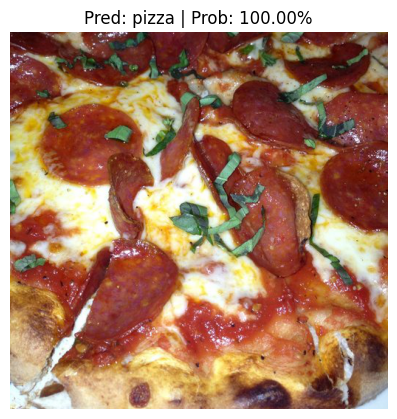

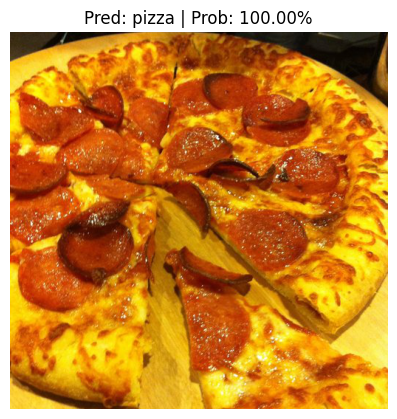

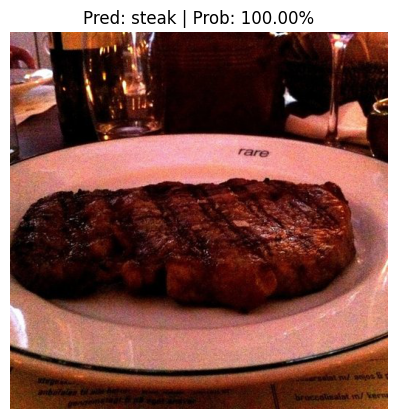

In [ ]:
TEST_DIR  = DATA_PATH + "data_20percent/test"

test_images = ?.?(TEST_DIR+"/*/*.jpg") # import glob
random_img_3 = random.?(test_images, k=3)

weights = torchvision.models.ConvNeXt_?.DEFAULT
transform_convnext_tiny = weights.?()


for image_path in random_img_3:

    predict_img(model=best_model,
                image_path=image_path,
                class_names=['pizza', 'steak', 'sushi'],
                transform=?,
                device=device)

In [ ]:
files.download('/gdrive/MyDrive/data_food101/models/' + '4_ConvNeXt_Tiny_data_100_percent_30_epochs.pth') # from google.colab import files

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>